In [1]:
#Importing drive on colab
from google.colab import drive

In [2]:
import pathlib

In [3]:
#importing video
video = '/content/drive/MyDrive/Pexels Videos 2034115_Trim.mp4'

In [4]:

# importing all the necessary libraries.

import cv2
import os
import pathlib

import matplotlib
import matplotlib.pyplot as plt

import io
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from six.moves.urllib.request import urlopen

import tensorflow as tf
import tensorflow_hub as hub

tf.get_logger().setLevel('ERROR')

from google.colab.patches import cv2_imshow

In [5]:
# saving all model links to an object
ALL_MODELS = {
'CenterNet HourGlass104 512x512' : 'https://tfhub.dev/tensorflow/centernet/hourglass_512x512/1',
'CenterNet HourGlass104 Keypoints 512x512' : 'https://tfhub.dev/tensorflow/centernet/hourglass_512x512_kpts/1',
'CenterNet HourGlass104 1024x1024' : 'https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024/1',
'CenterNet HourGlass104 Keypoints 1024x1024' : 'https://tfhub.dev/tensorflow/centernet/hourglass_1024x1024_kpts/1',
'CenterNet Resnet50 V1 FPN 512x512' : 'https://tfhub.dev/tensorflow/centernet/resnet50v1_fpn_512x512/1',
'CenterNet Resnet50 V1 FPN Keypoints 512x512' : 'https://tfhub.dev/tensorflow/centernet/resnet50v1_fpn_512x512_kpts/1',
'CenterNet Resnet101 V1 FPN 512x512' : 'https://tfhub.dev/tensorflow/centernet/resnet101v1_fpn_512x512/1',
'CenterNet Resnet50 V2 512x512' : 'https://tfhub.dev/tensorflow/centernet/resnet50v2_512x512/1',
'CenterNet Resnet50 V2 Keypoints 512x512' : 'https://tfhub.dev/tensorflow/centernet/resnet50v2_512x512_kpts/1',
'EfficientDet D0 512x512' : 'https://tfhub.dev/tensorflow/efficientdet/d0/1',
'EfficientDet D1 640x640' : 'https://tfhub.dev/tensorflow/efficientdet/d1/1',
'EfficientDet D2 768x768' : 'https://tfhub.dev/tensorflow/efficientdet/d2/1',
'EfficientDet D3 896x896' : 'https://tfhub.dev/tensorflow/efficientdet/d3/1',
'EfficientDet D4 1024x1024' : 'https://tfhub.dev/tensorflow/efficientdet/d4/1',
'EfficientDet D5 1280x1280' : 'https://tfhub.dev/tensorflow/efficientdet/d5/1',
'EfficientDet D6 1280x1280' : 'https://tfhub.dev/tensorflow/efficientdet/d6/1',
'EfficientDet D7 1536x1536' : 'https://tfhub.dev/tensorflow/efficientdet/d7/1',
'SSD MobileNet v2 320x320' : 'https://tfhub.dev/tensorflow/ssd_mobilenet_v2/2',
'SSD MobileNet V1 FPN 640x640' : 'https://tfhub.dev/tensorflow/ssd_mobilenet_v1/fpn_640x640/1',
'SSD MobileNet V2 FPNLite 320x320' : 'https://tfhub.dev/tensorflow/ssd_mobilenet_v2/fpnlite_320x320/1',
'SSD MobileNet V2 FPNLite 640x640' : 'https://tfhub.dev/tensorflow/ssd_mobilenet_v2/fpnlite_640x640/1',
'SSD ResNet50 V1 FPN 640x640 (RetinaNet50)' : 'https://tfhub.dev/tensorflow/retinanet/resnet50_v1_fpn_640x640/1',
'SSD ResNet50 V1 FPN 1024x1024 (RetinaNet50)' : 'https://tfhub.dev/tensorflow/retinanet/resnet50_v1_fpn_1024x1024/1',
'SSD ResNet101 V1 FPN 640x640 (RetinaNet101)' : 'https://tfhub.dev/tensorflow/retinanet/resnet101_v1_fpn_640x640/1',
'SSD ResNet101 V1 FPN 1024x1024 (RetinaNet101)' : 'https://tfhub.dev/tensorflow/retinanet/resnet101_v1_fpn_1024x1024/1',
'SSD ResNet152 V1 FPN 640x640 (RetinaNet152)' : 'https://tfhub.dev/tensorflow/retinanet/resnet152_v1_fpn_640x640/1',
'SSD ResNet152 V1 FPN 1024x1024 (RetinaNet152)' : 'https://tfhub.dev/tensorflow/retinanet/resnet152_v1_fpn_1024x1024/1',
'Faster R-CNN ResNet50 V1 640x640' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet50_v1_640x640/1',
'Faster R-CNN ResNet50 V1 1024x1024' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet50_v1_1024x1024/1',
'Faster R-CNN ResNet50 V1 800x1333' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet50_v1_800x1333/1',
'Faster R-CNN ResNet101 V1 640x640' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet101_v1_640x640/1',
'Faster R-CNN ResNet101 V1 1024x1024' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet101_v1_1024x1024/1',
'Faster R-CNN ResNet101 V1 800x1333' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet101_v1_800x1333/1',
'Faster R-CNN ResNet152 V1 640x640' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet152_v1_640x640/1',
'Faster R-CNN ResNet152 V1 1024x1024' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet152_v1_1024x1024/1',
'Faster R-CNN ResNet152 V1 800x1333' : 'https://tfhub.dev/tensorflow/faster_rcnn/resnet152_v1_800x1333/1',
'Faster R-CNN Inception ResNet V2 640x640' : 'https://tfhub.dev/tensorflow/faster_rcnn/inception_resnet_v2_640x640/1',
'Faster R-CNN Inception ResNet V2 1024x1024' : 'https://tfhub.dev/tensorflow/faster_rcnn/inception_resnet_v2_1024x1024/1',
'Mask R-CNN Inception ResNet V2 1024x1024' : 'https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1'
}

COCO17_HUMAN_POSE_KEYPOINTS = [(0, 1),
 (0, 2),
 (1, 3),
 (2, 4),
 (0, 5),
 (0, 6),
 (5, 7),
 (7, 9),
 (6, 8),
 (8, 10),
 (5, 6),
 (5, 11),
 (6, 12),
 (11, 12),
 (11, 13),
 (13, 15),
 (12, 14),
 (14, 16)]

In [6]:
# Clone the tensorflow models repository
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 3691, done.
remote: Counting objects: 100% (3691/3691), done.
remote: Compressing objects: 100% (3079/3079), done.
remote: Total 3691 (delta 990), reused 1510 (delta 561), pack-reused 0
Receiving objects: 100% (3691/3691), 48.75 MiB | 15.88 MiB/s, done.
Resolving deltas: 100% (990/990), done.


In [7]:
#installing compiler
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Reading package lists...
Building dependency tree...
Reading state information...
protobuf-compiler is already the newest version (3.6.1.3-2ubuntu5).
0 upgraded, 0 newly installed, 0 to remove and 19 not upgraded.
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing /content/models/research
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.6/14.6 MB 31.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 352.1/352.1 KB 32.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 65.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 26.9/26.9 MB 45.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1

In [8]:
#importing modules

from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import ops as utils_ops

%matplotlib inline

In [9]:
# Creating labels from coco dataset list of labels

Labels = './models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(Labels, use_display_name=True)

In [10]:
#@title Model Selection { display-mode: "form", run: "auto" }
model_name = 'Mask R-CNN Inception ResNet V2 1024x1024'# @param ['CenterNet HourGlass104 512x512','CenterNet HourGlass104 Keypoints 512x512','CenterNet HourGlass104 1024x1024','CenterNet HourGlass104 Keypoints 1024x1024','CenterNet Resnet50 V1 FPN 512x512','CenterNet Resnet50 V1 FPN Keypoints 512x512','CenterNet Resnet101 V1 FPN 512x512','CenterNet Resnet50 V2 512x512','CenterNet Resnet50 V2 Keypoints 512x512','EfficientDet D0 512x512','EfficientDet D1 640x640','EfficientDet D2 768x768','EfficientDet D3 896x896','EfficientDet D4 1024x1024','EfficientDet D5 1280x1280','EfficientDet D6 1280x1280','EfficientDet D7 1536x1536','SSD MobileNet v2 320x320','SSD MobileNet V1 FPN 640x640','SSD MobileNet V2 FPNLite 320x320','SSD MobileNet V2 FPNLite 640x640','SSD ResNet50 V1 FPN 640x640 (RetinaNet50)','SSD ResNet50 V1 FPN 1024x1024 (RetinaNet50)','SSD ResNet101 V1 FPN 640x640 (RetinaNet101)','SSD ResNet101 V1 FPN 1024x1024 (RetinaNet101)','SSD ResNet152 V1 FPN 640x640 (RetinaNet152)','SSD ResNet152 V1 FPN 1024x1024 (RetinaNet152)','Faster R-CNN ResNet50 V1 640x640','Faster R-CNN ResNet50 V1 1024x1024','Faster R-CNN ResNet50 V1 800x1333','Faster R-CNN ResNet101 V1 640x640','Faster R-CNN ResNet101 V1 1024x1024','Faster R-CNN ResNet101 V1 800x1333','Faster R-CNN ResNet152 V1 640x640','Faster R-CNN ResNet152 V1 1024x1024','Faster R-CNN ResNet152 V1 800x1333','Faster R-CNN Inception ResNet V2 640x640','Faster R-CNN Inception ResNet V2 1024x1024','Mask R-CNN Inception ResNet V2 1024x1024']
model_handle = ALL_MODELS[model_name]

print('Selected model:'+ model_name)
print('Model Handle at TensorFlow Hub: {}'.format(model_handle))

Selected model:Mask R-CNN Inception ResNet V2 1024x1024
Model Handle at TensorFlow Hub: https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1


In [11]:
# loading the above selected model into hub_model 
#print('loading model...')
hub_model = hub.load(model_handle)

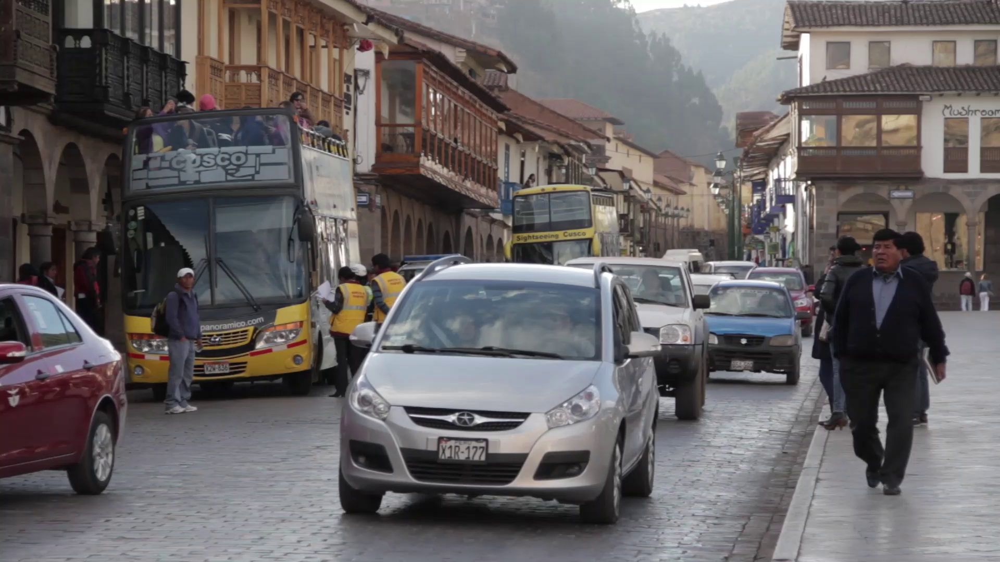

In [12]:
#Converting video to image frames
#Displaying one video frame

convert = cv2.VideoCapture(video)
ret, frame = convert.read()
cv2_imshow(frame)



In [13]:
frame.shape 

(1080, 1920, 3)

In [16]:
num_frames = int(convert.get(cv2.CAP_PROP_FRAME_COUNT))
print("Number of frames in video: ", num_frames)

Number of frames in video:  191


In [17]:
#creating a function to visualise results input parameters as numpy image 
# result is stored as a prpcessed image with bounding boxes

def visualizing_the_results(image_np,result):
  label_id_offset = 0
  image_np_with_detections = image_np.copy()

  # Use keypoints if available in detections
  keypoints, keypoint_scores = None, None
  if 'detection_keypoints' in result:
    keypoints = result['detection_keypoints'][0]
    keypoint_scores = result['detection_keypoint_scores'][0]

  viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections[0],
      result['detection_boxes'][0],
      (result['detection_classes'][0] + label_id_offset).astype(int),
      result['detection_scores'][0],
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.30,
      agnostic_mode=False,
      keypoints=keypoints,
      keypoint_scores=keypoint_scores,
      keypoint_edges=COCO17_HUMAN_POSE_KEYPOINTS)
  return image_np_with_detections[0]
  plt.show()

In [20]:
# creating an output file in the drive location to store output file.
FILE_OUTPUT = '/content/drive/MyDrive/output.mp4'
if os.path.isfile(FILE_OUTPUT):
    os.remove(FILE_OUTPUT)
out = cv2.VideoWriter(FILE_OUTPUT, cv2.VideoWriter_fourcc(*'mp4v'),
                      10, (300, 300))

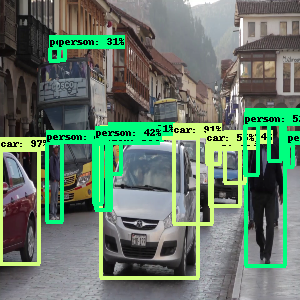

frame 1 processed


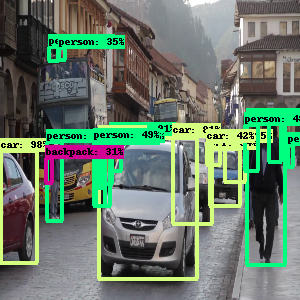

frame 2 processed


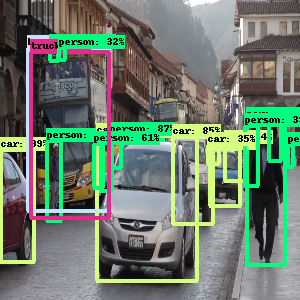

frame 3 processed


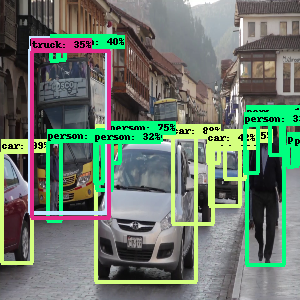

frame 4 processed


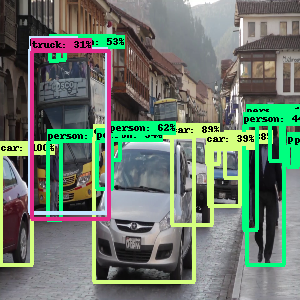

frame 5 processed


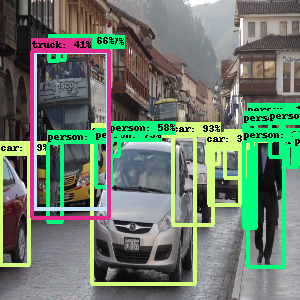

frame 6 processed


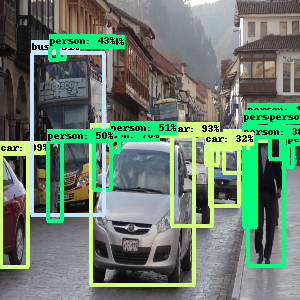

frame 7 processed


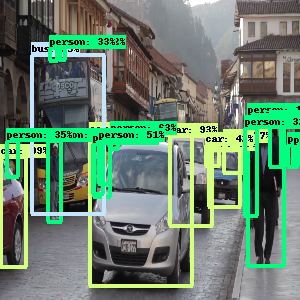

frame 8 processed


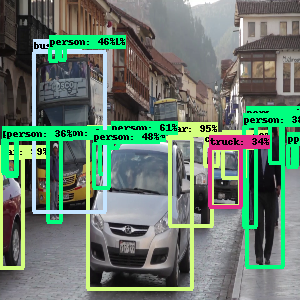

frame 9 processed


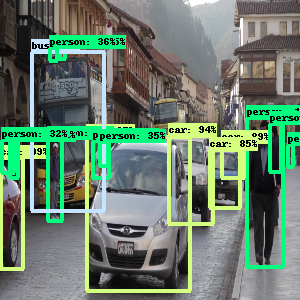

frame 10 processed


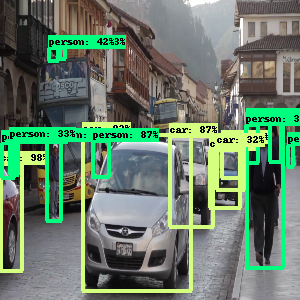

frame 11 processed


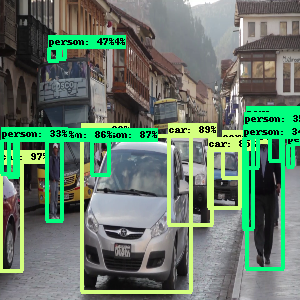

frame 12 processed


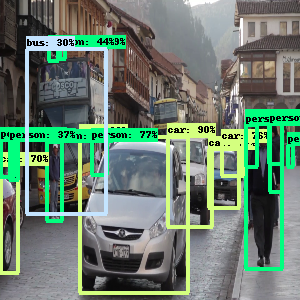

frame 13 processed


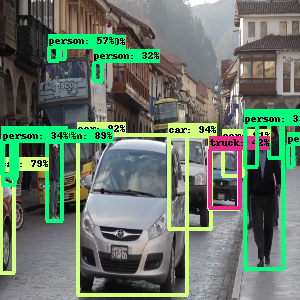

frame 14 processed


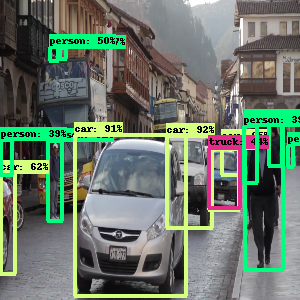

frame 15 processed


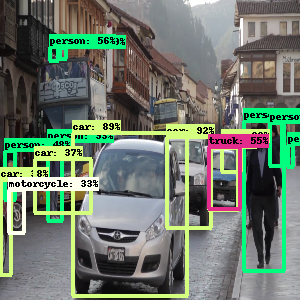

frame 16 processed


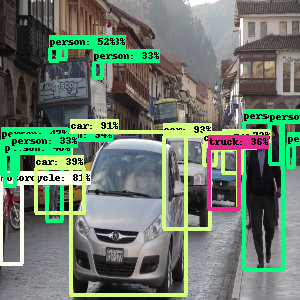

frame 17 processed


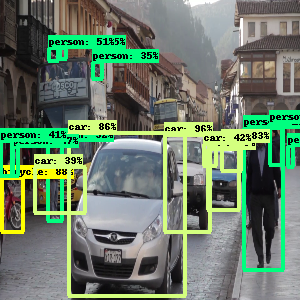

frame 18 processed


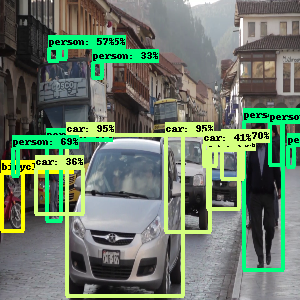

frame 19 processed


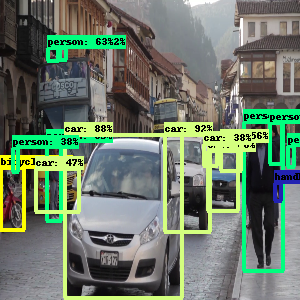

frame 20 processed


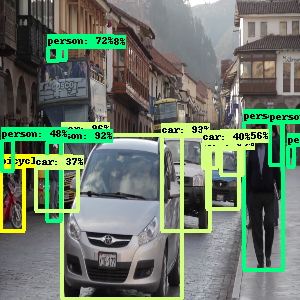

frame 21 processed


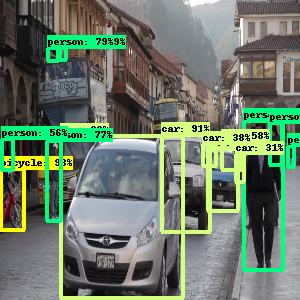

frame 22 processed


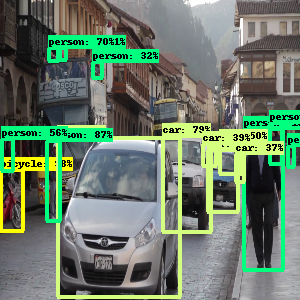

frame 23 processed


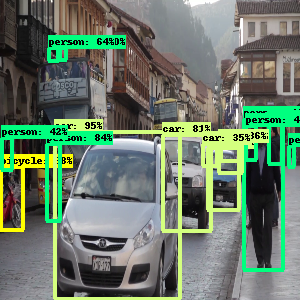

frame 24 processed


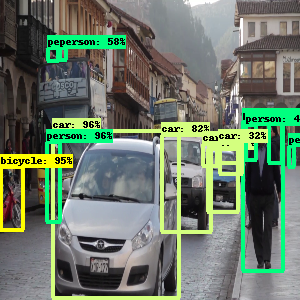

frame 25 processed


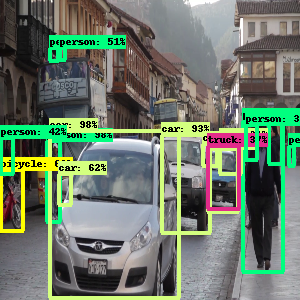

frame 26 processed


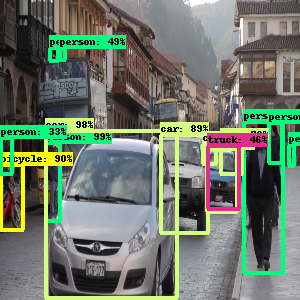

frame 27 processed


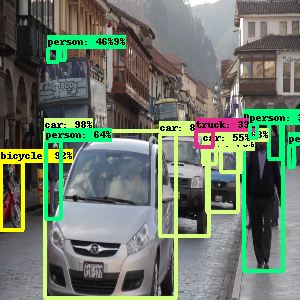

frame 28 processed


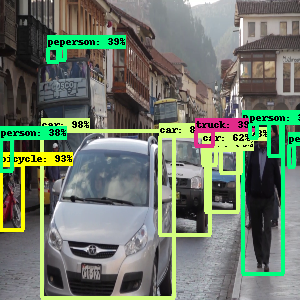

frame 29 processed


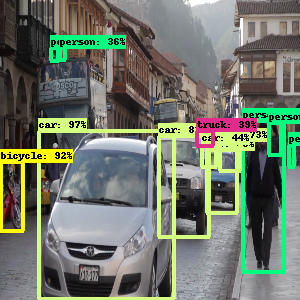

frame 30 processed


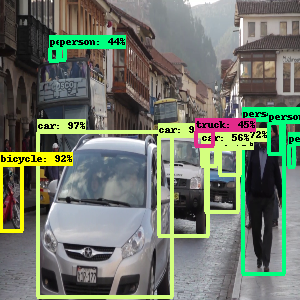

frame 31 processed


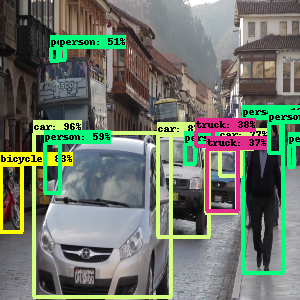

frame 32 processed


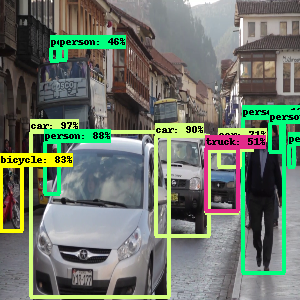

frame 33 processed


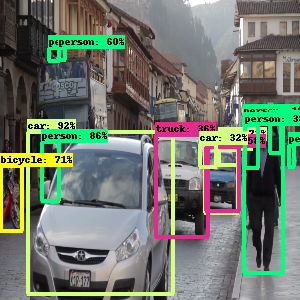

frame 34 processed


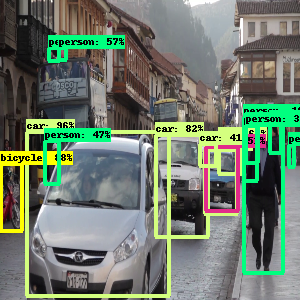

frame 35 processed


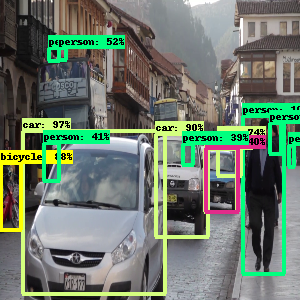

frame 36 processed


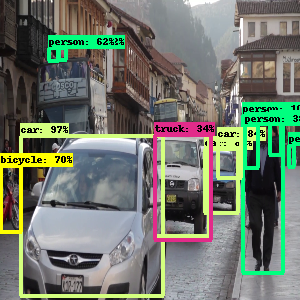

frame 37 processed


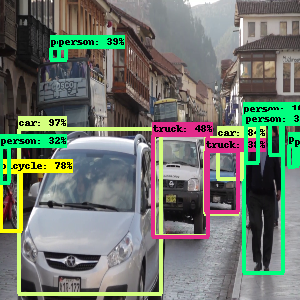

frame 38 processed


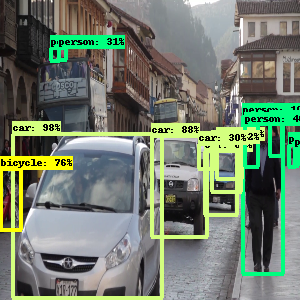

frame 39 processed


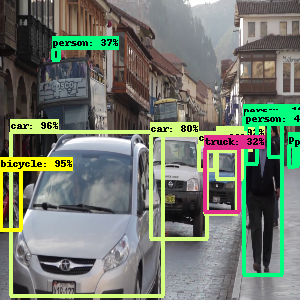

frame 40 processed


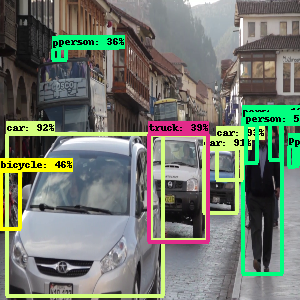

frame 41 processed


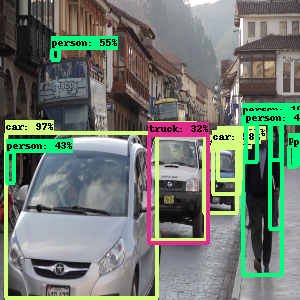

frame 42 processed


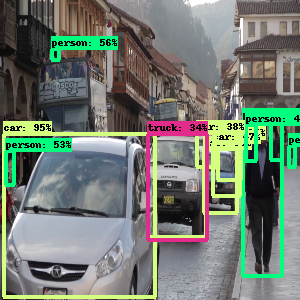

frame 43 processed


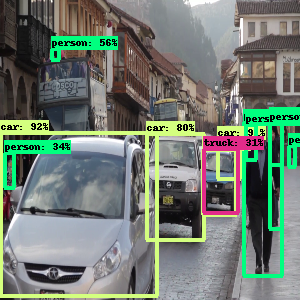

frame 44 processed


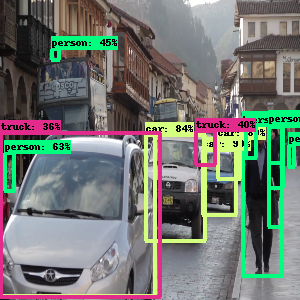

frame 45 processed


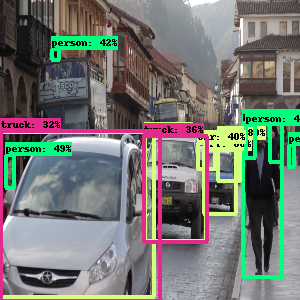

frame 46 processed


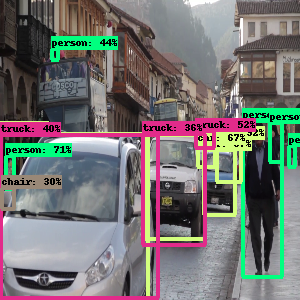

frame 47 processed


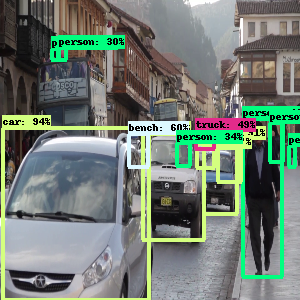

frame 48 processed


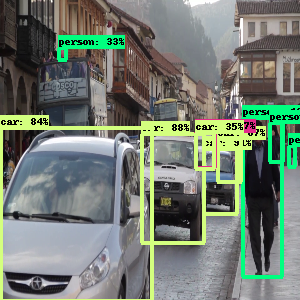

frame 49 processed


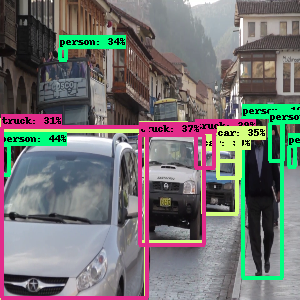

frame 50 processed


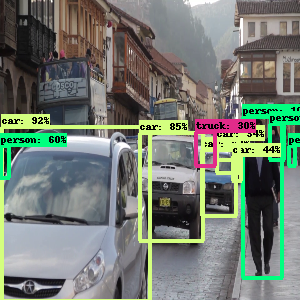

frame 51 processed


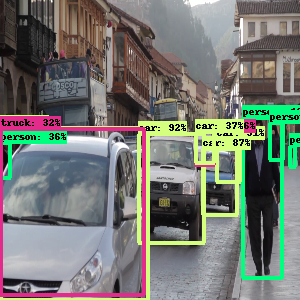

frame 52 processed


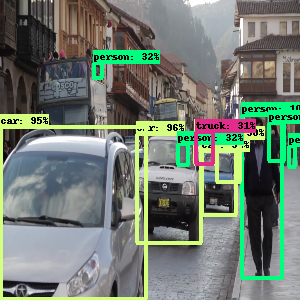

frame 53 processed


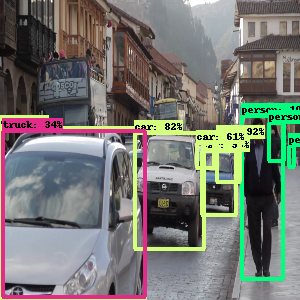

frame 54 processed


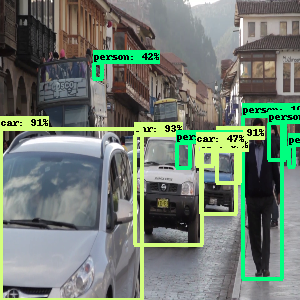

frame 55 processed


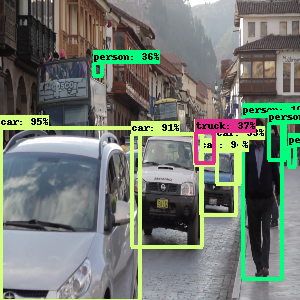

frame 56 processed


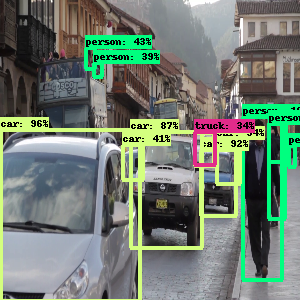

frame 57 processed


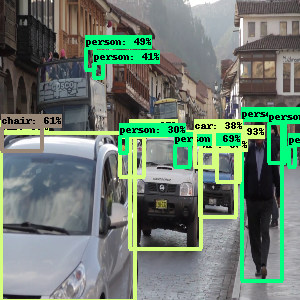

frame 58 processed


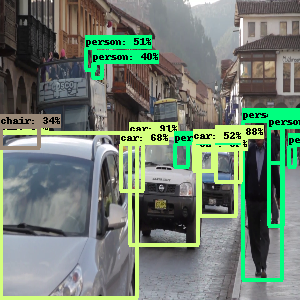

frame 59 processed


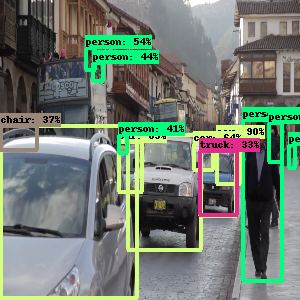

frame 60 processed


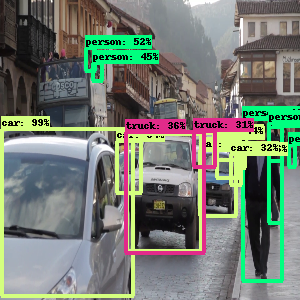

frame 61 processed


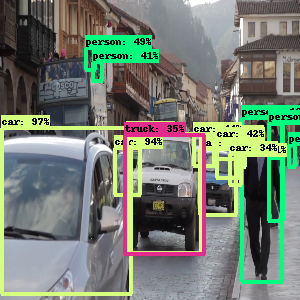

frame 62 processed


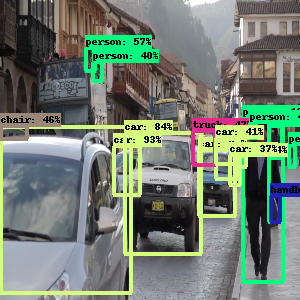

frame 63 processed


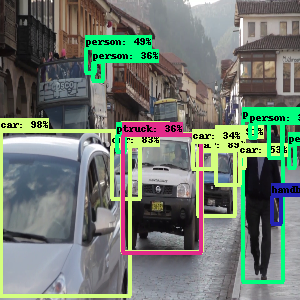

frame 64 processed


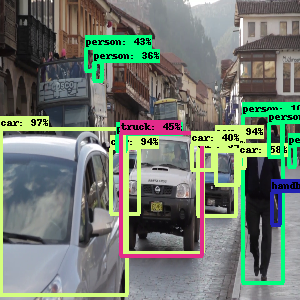

frame 65 processed


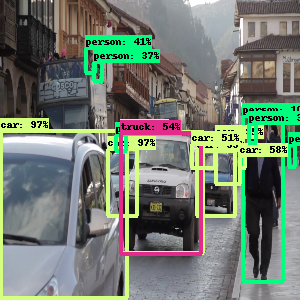

frame 66 processed


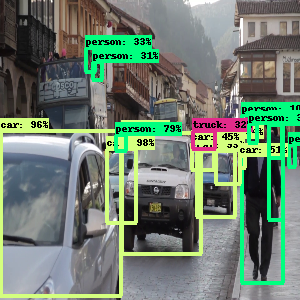

frame 67 processed


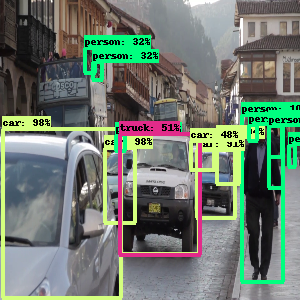

frame 68 processed


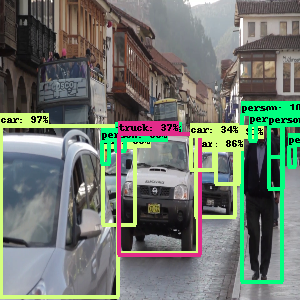

frame 69 processed


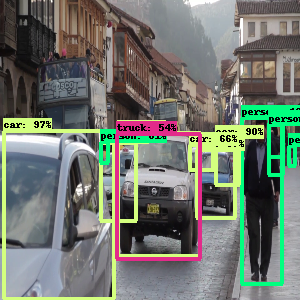

frame 70 processed


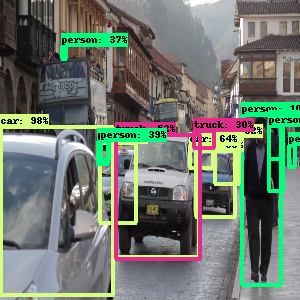

frame 71 processed


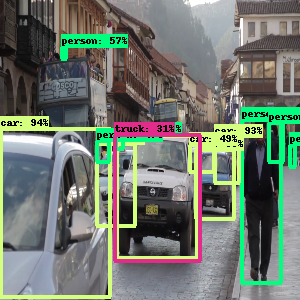

frame 72 processed


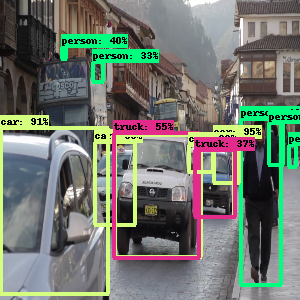

frame 73 processed


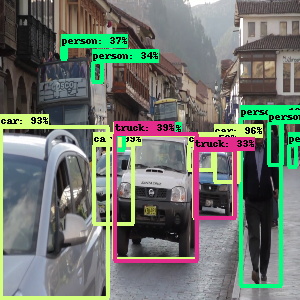

frame 74 processed


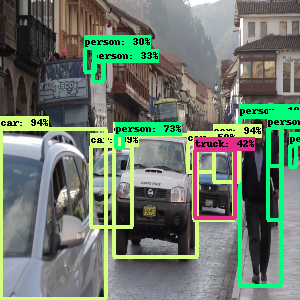

frame 75 processed


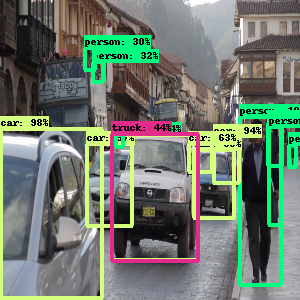

frame 76 processed


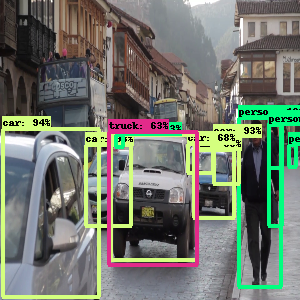

frame 77 processed


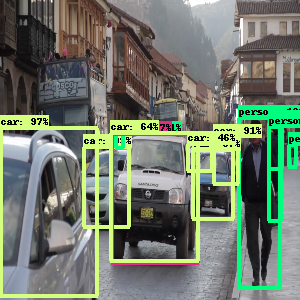

frame 78 processed


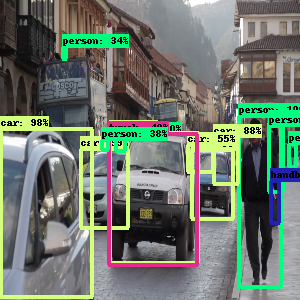

frame 79 processed


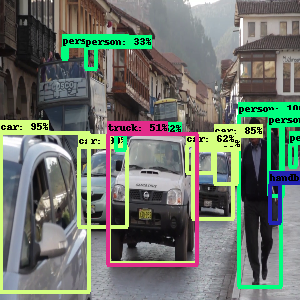

frame 80 processed


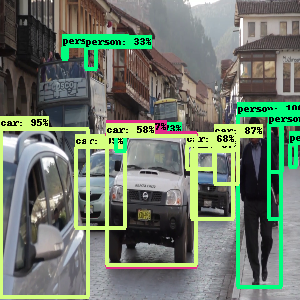

frame 81 processed


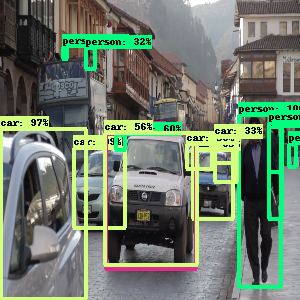

frame 82 processed


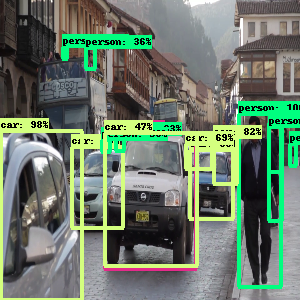

frame 83 processed


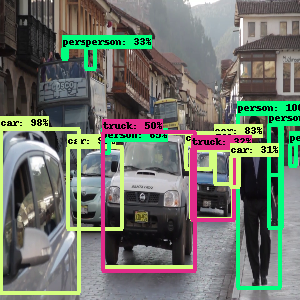

frame 84 processed


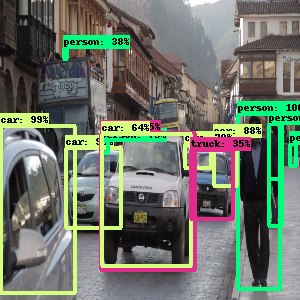

frame 85 processed


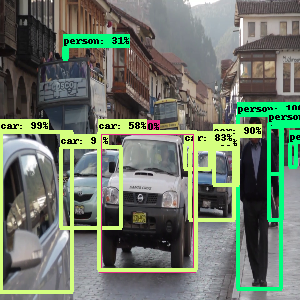

frame 86 processed


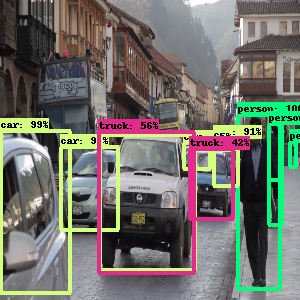

frame 87 processed


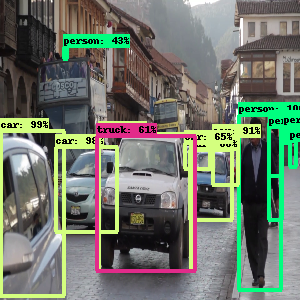

frame 88 processed


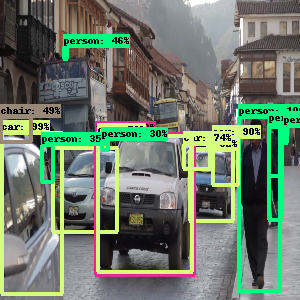

frame 89 processed


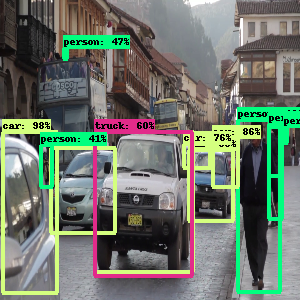

frame 90 processed


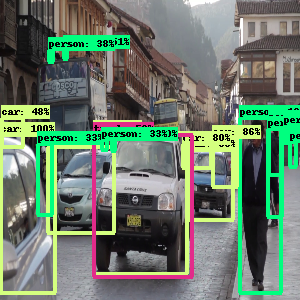

frame 91 processed


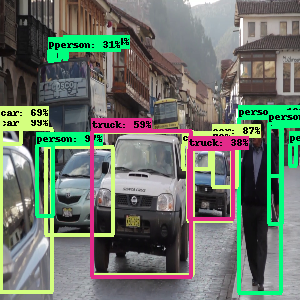

frame 92 processed


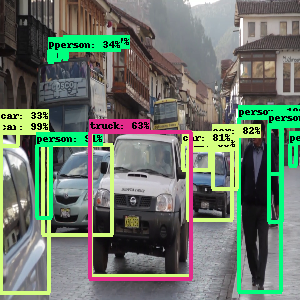

frame 93 processed


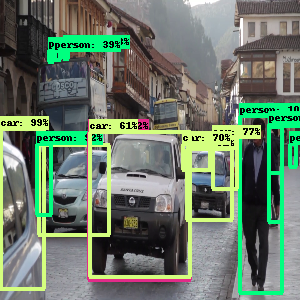

frame 94 processed


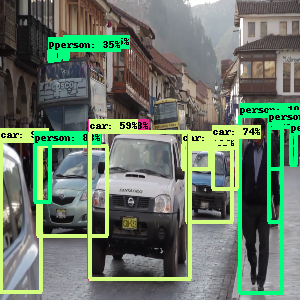

frame 95 processed


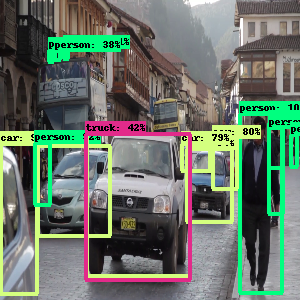

frame 96 processed


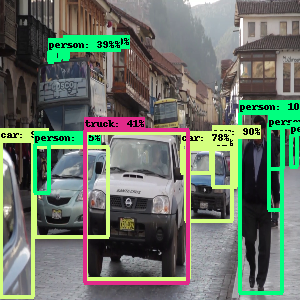

frame 97 processed


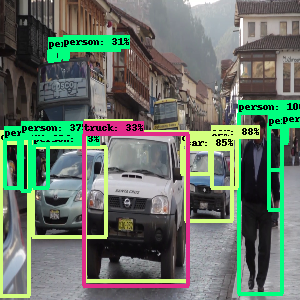

frame 98 processed


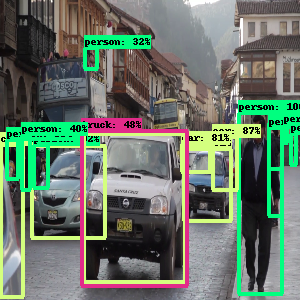

frame 99 processed


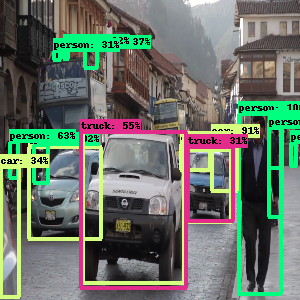

frame 100 processed


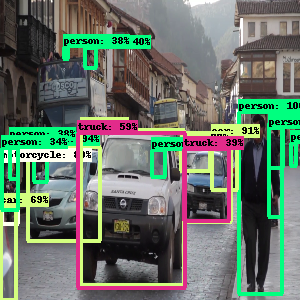

frame 101 processed


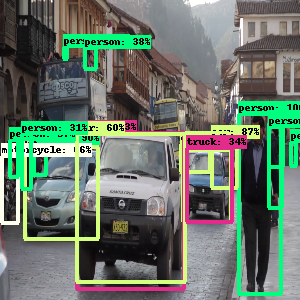

frame 102 processed


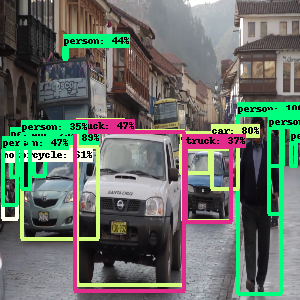

frame 103 processed


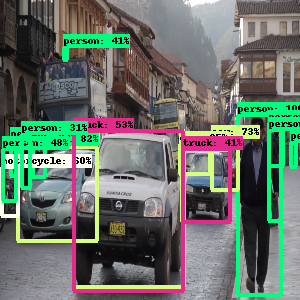

frame 104 processed


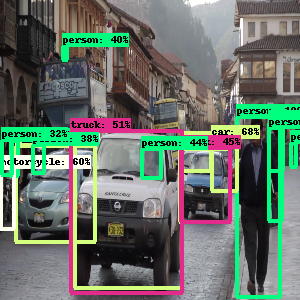

frame 105 processed


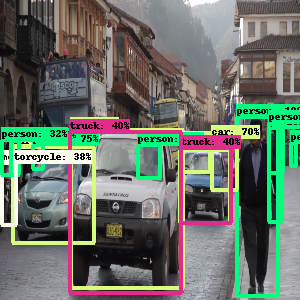

frame 106 processed


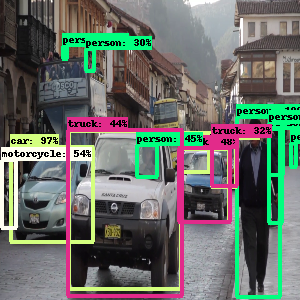

frame 107 processed


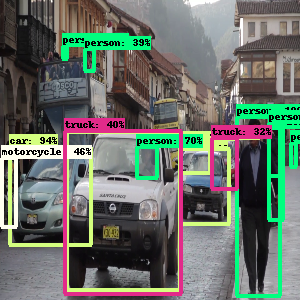

frame 108 processed


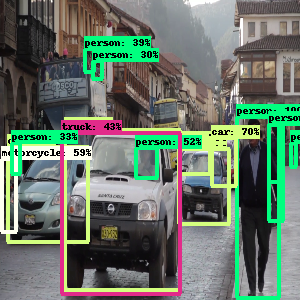

frame 109 processed


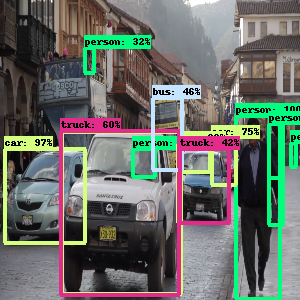

frame 110 processed


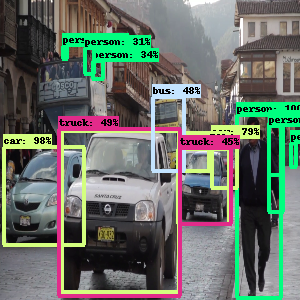

frame 111 processed


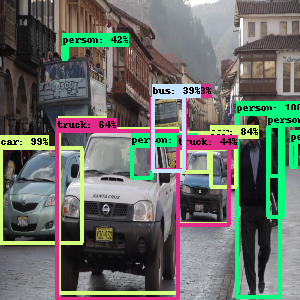

frame 112 processed


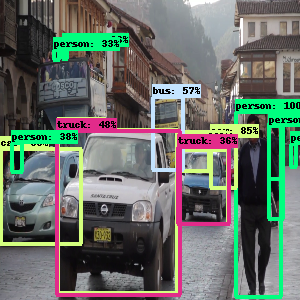

frame 113 processed


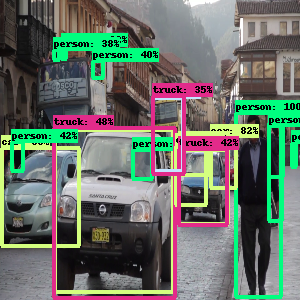

frame 114 processed


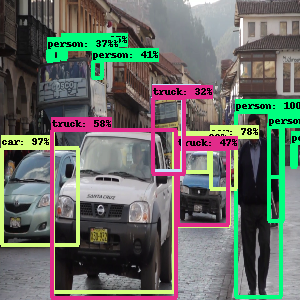

frame 115 processed


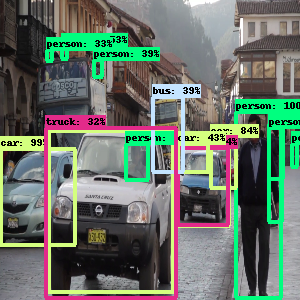

frame 116 processed


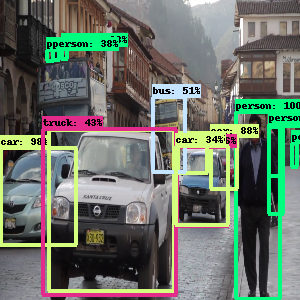

frame 117 processed


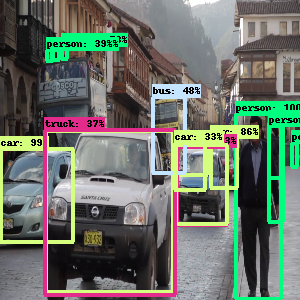

frame 118 processed


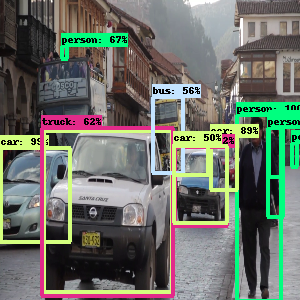

frame 119 processed


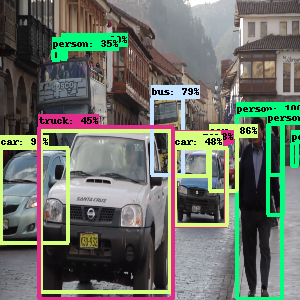

frame 120 processed


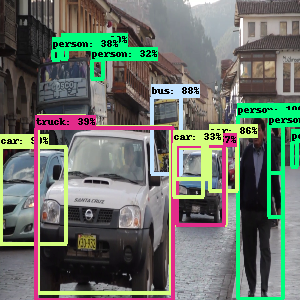

frame 121 processed


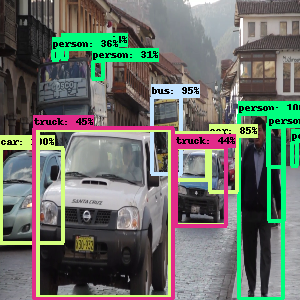

frame 122 processed


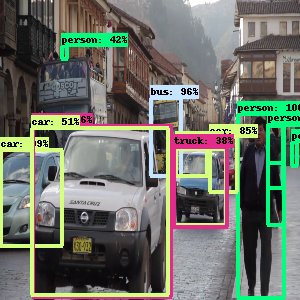

frame 123 processed


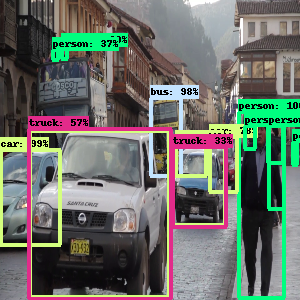

frame 124 processed


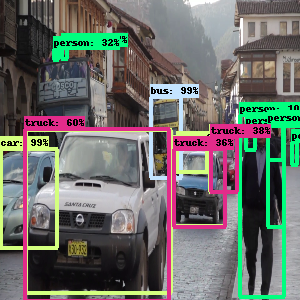

frame 125 processed


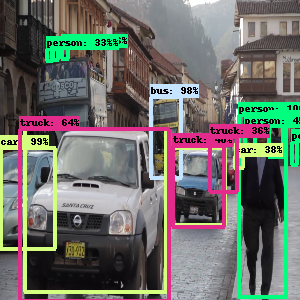

frame 126 processed


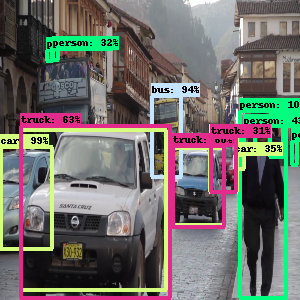

frame 127 processed


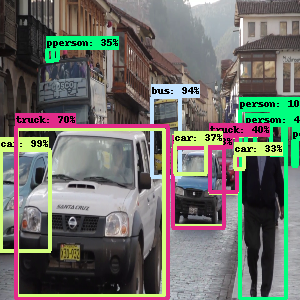

frame 128 processed


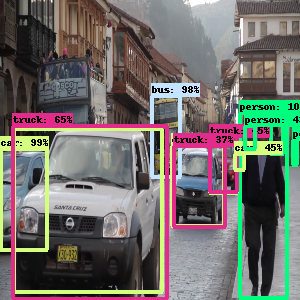

frame 129 processed


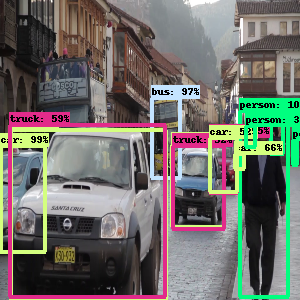

frame 130 processed


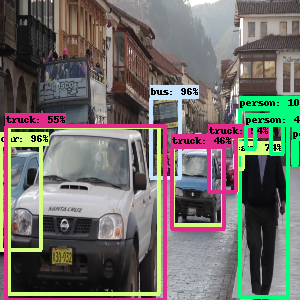

frame 131 processed


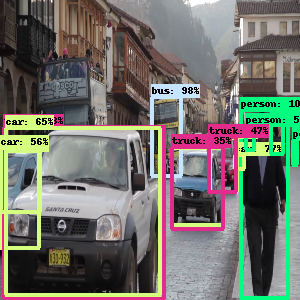

frame 132 processed


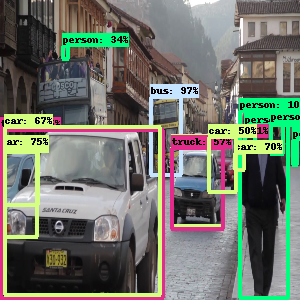

frame 133 processed


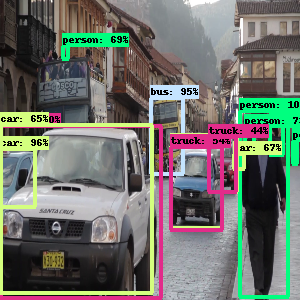

frame 134 processed


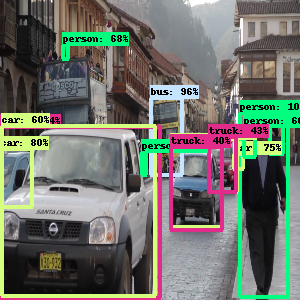

frame 135 processed


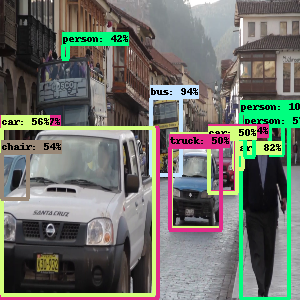

frame 136 processed


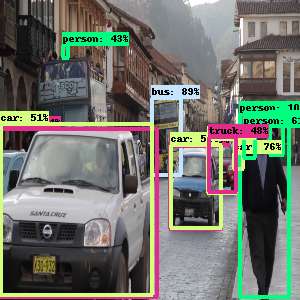

frame 137 processed


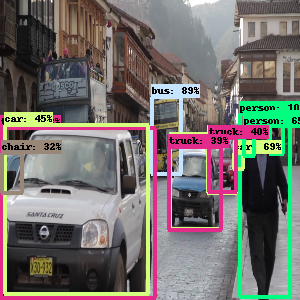

frame 138 processed


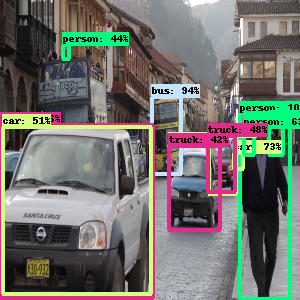

frame 139 processed


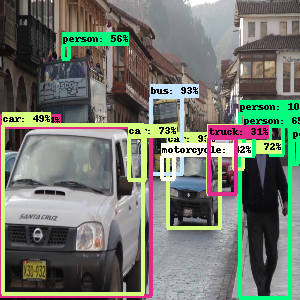

frame 140 processed


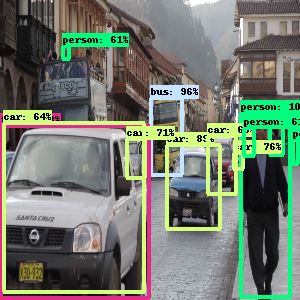

frame 141 processed


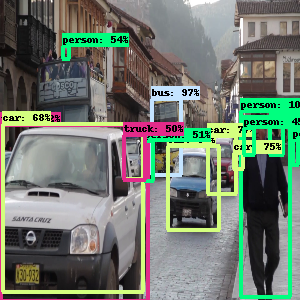

frame 142 processed


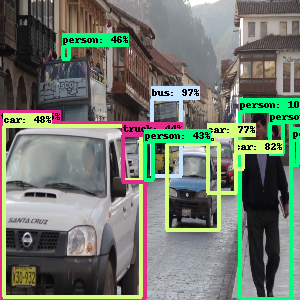

frame 143 processed


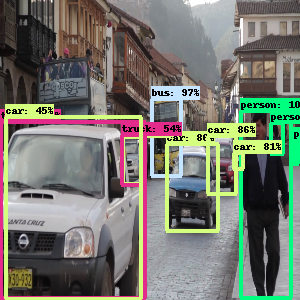

frame 144 processed


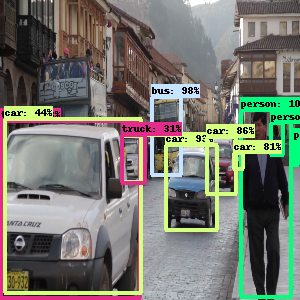

frame 145 processed


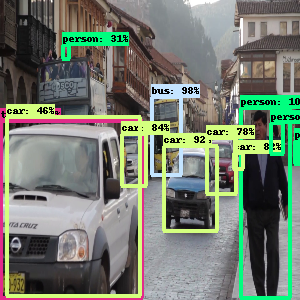

frame 146 processed


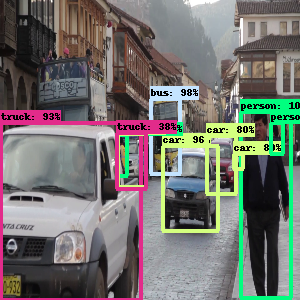

frame 147 processed


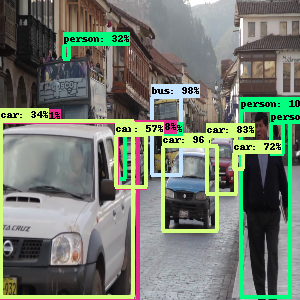

frame 148 processed


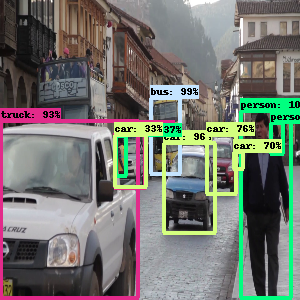

frame 149 processed


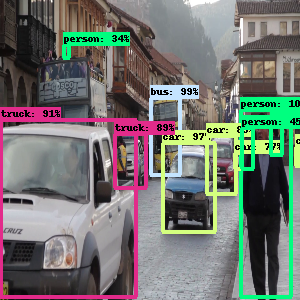

frame 150 processed


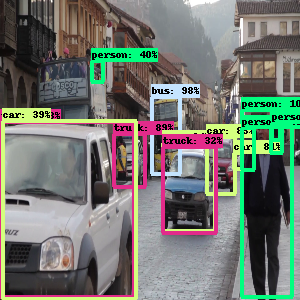

frame 151 processed


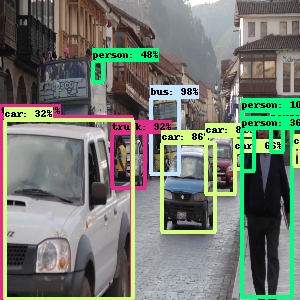

frame 152 processed


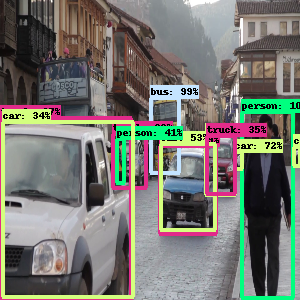

frame 153 processed


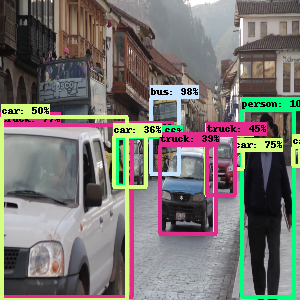

frame 154 processed


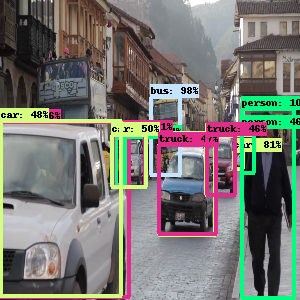

frame 155 processed


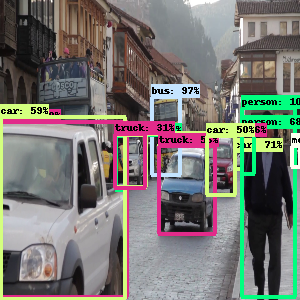

frame 156 processed


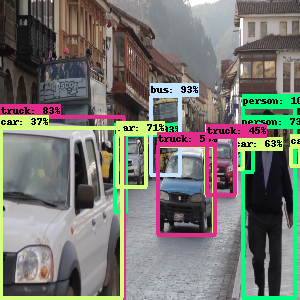

frame 157 processed


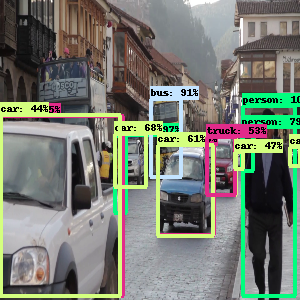

frame 158 processed


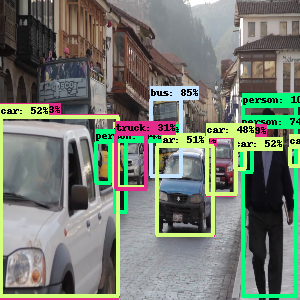

frame 159 processed


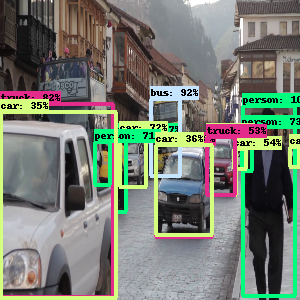

frame 160 processed


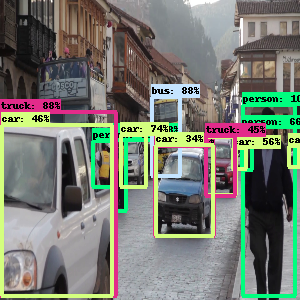

frame 161 processed


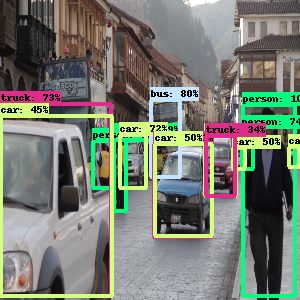

frame 162 processed


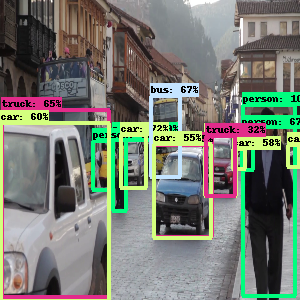

frame 163 processed


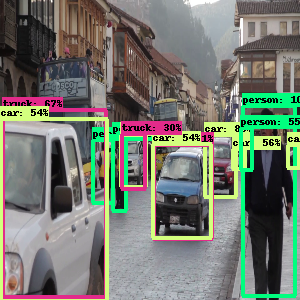

frame 164 processed


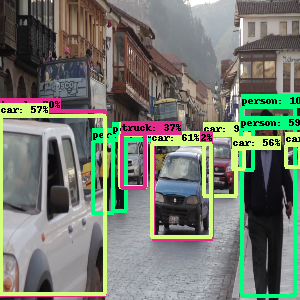

frame 165 processed


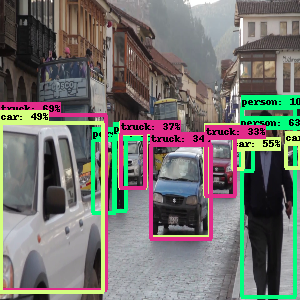

frame 166 processed


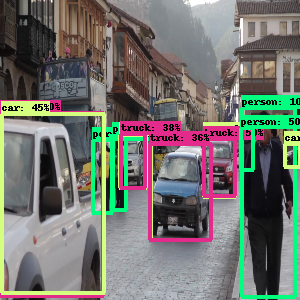

frame 167 processed


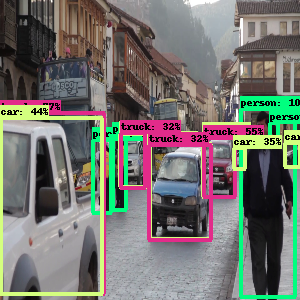

frame 168 processed


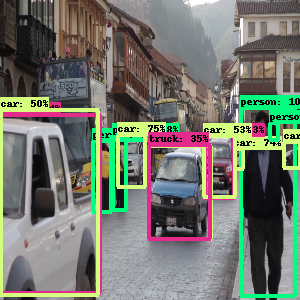

frame 169 processed


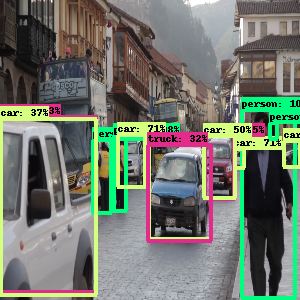

frame 170 processed


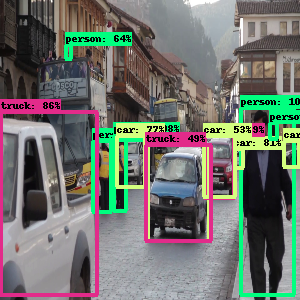

frame 171 processed


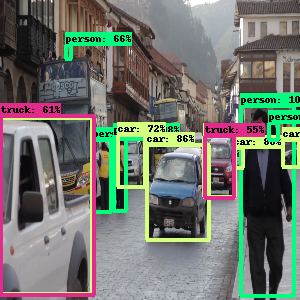

frame 172 processed


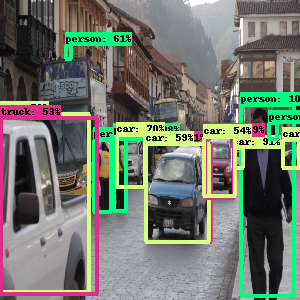

frame 173 processed


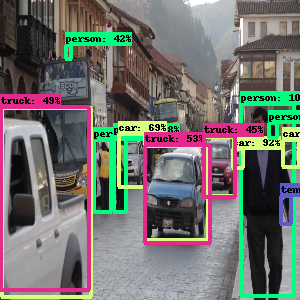

frame 174 processed


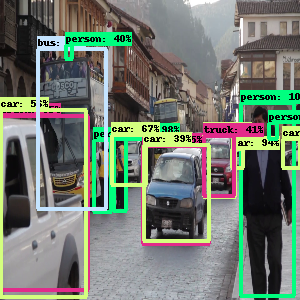

frame 175 processed


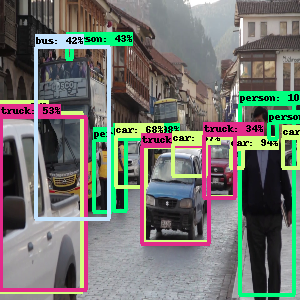

frame 176 processed


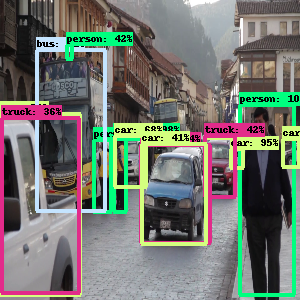

frame 177 processed


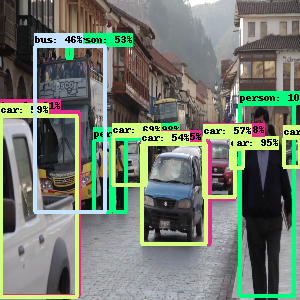

frame 178 processed


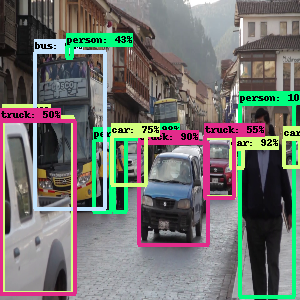

frame 179 processed


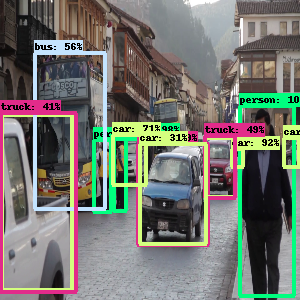

frame 180 processed


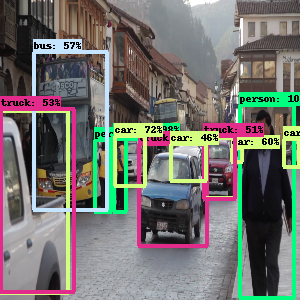

frame 181 processed


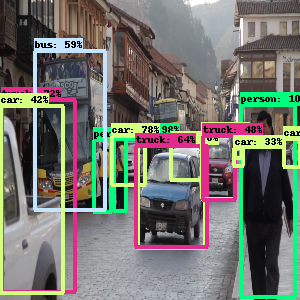

frame 182 processed


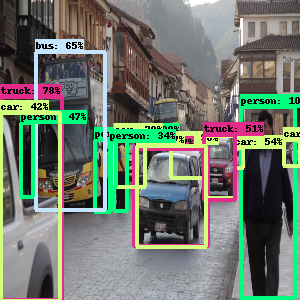

frame 183 processed


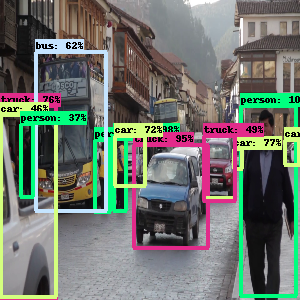

frame 184 processed


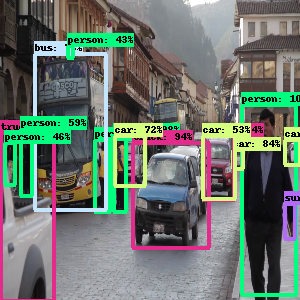

frame 185 processed


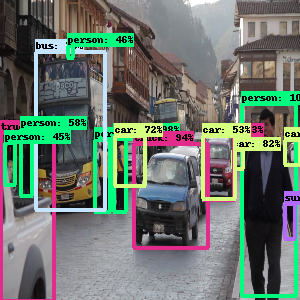

frame 186 processed


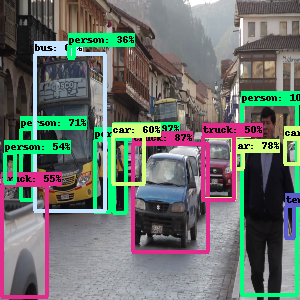

frame 187 processed


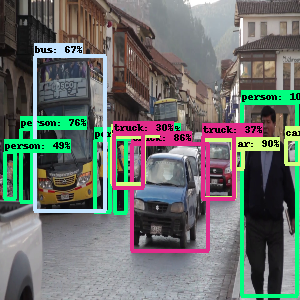

frame 188 processed


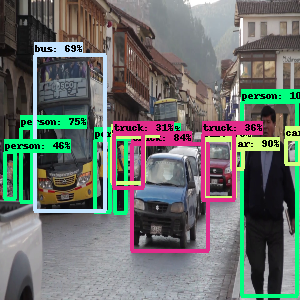

frame 189 processed


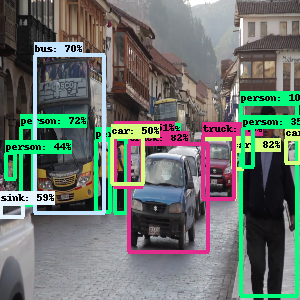

frame 190 processed


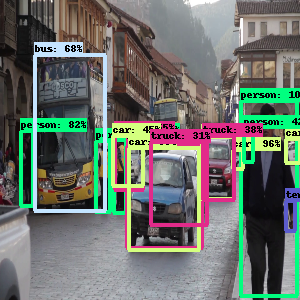

frame 191 processed
vid not Present


In [21]:
"""below code breaks down video into one frame at a time and then processes each
frame and executes the visualisation function, applies the bounding boxes to each frames and stores the resulted images as
video in output file
"""
vid = cv2.VideoCapture(video)
count = 0
while True:
    ret, frame = vid.read()
    if ret == True:
      frame = cv2.resize(frame,(300,300))
      frame_np = np.array(frame.reshape((1, 300, 300, 3)).astype(np.uint8))
      results = hub_model(frame_np)
      result = {key:value.numpy() for key,value in results.items()}
      frame_with_detections = visualizing_the_results(frame_np,result)
      out.write(frame_with_detections)
      cv2_imshow(frame_with_detections)
      count += 1
      print('frame',count,'processed')
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break
    if ret == False:
        print('vid not Present')
        break

vid.release()
out.release()





I have used "Pexels Videos 2034115_Trim" as my input video and the output video is named as "output.mp4". Both the videos are attached in the folder and zipped together with the code. 
